# Comparison Between Mapping Libraries in Python

### Import Modules

In [3]:
import pandas as pd
import numpy as np

### Load Data

In [4]:
input_data_directory = '../../../../data/meteorologia/clean'

alertario = pd.read_csv(f'{input_data_directory}/clima_pluviometro/taxa_precipitacao_alertario_manual.csv', nrows=10000)
estacoes_alertario = pd.read_csv(f'{input_data_directory}/clima_pluviometro/estacoes_alertario.csv')
ocorrencias = pd.read_csv(f'{input_data_directory}/adm_cor_comando/ocorrencias.csv')
pops = pd.read_csv('../../data/raw/adm_cor_comando/pops.csv', index_col=0)

### Preprocessing `taxa_precipitacao_alertario`

In [5]:
# Convert datetime data type fields
alertario['horario'] = pd.to_timedelta(alertario['horario'])
alertario['data_particao'] = pd.to_datetime(alertario['data_particao'])
alertario['timestamp'] = pd.to_datetime(alertario['timestamp'])

# Map station name and coordinates
station_name_map = estacoes_alertario.set_index('id_estacao')['estacao']
alertario['estacao'] = alertario['id_estacao'].map(station_name_map)

# station_latitude_map = estacoes_alertario.set_index('id_estacao')['latitude']
# alertario['latitude'] = alertario['id_estacao'].map(station_latitude_map)

# station_longitude_map = estacoes_alertario.set_index('id_estacao')['longitude']
# alertario['longitude'] = alertario['id_estacao'].map(station_longitude_map)

# Reorder columns
alertario = alertario[[
    'primary_key',
    'id_estacao',
    'estacao',
    # 'latitude',
    # 'longitude',
    'horario',
    'data_particao',
    'timestamp',
    'acumulado_chuva_15_min',
    'acumulado_chuva_1_h',
    'acumulado_chuva_4_h',
    'acumulado_chuva_24_h',
    'acumulado_chuva_96_h'
]]

### Preprocessing `ocorrencias`

In [6]:
# Convert datetime data type fields
ocorrencias['data_inicio'] = pd.to_datetime(ocorrencias['data_inicio'])
ocorrencias['data_fim'] = pd.to_datetime(ocorrencias['data_fim'])

# Map event type
ocorrencias['tipo'] = ocorrencias['id_pop'].map(pops.set_index('id')['titulo'])

### Filter flood events

In [7]:
flood_types = [
    "Bolsão d'água em via",
    'Alagamentos e enchentes',
    "Lâmina d'água"
]

ocorrencias = ocorrencias[ocorrencias['tipo'].isin(flood_types)]

---

## Data Visualization of Flood Events

# Data Visualization of Flood Events in Rio de Janeiro

This Jupyter Notebook implements a comprehensive data visualization plan to analyze flood events in Rio de Janeiro, using the dataset loaded into the `ocorrencias` variable. We will use Plotly for creating interactive and informative visualizations.

## 1. Data Overview & Preprocessing

In this section, we will load the necessary libraries, inspect the dataset, and perform data cleaning and feature engineering steps as outlined in the plan.

In [8]:
# !pip install wordcloud
# !pip install nltk
# !pip install cartopy
# !pip install geopandas
# !pip install rasterio
# !pip install contextily

import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import numpy as np
from collections import Counter
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# print("First 5 rows of the DataFrame:")
# print(ocorrencias.head())
# print("\nDataFrame Info:")
# print(ocorrencias.info())

### Data Cleaning & Transformation

- Convert “data_inicio” and “data_fim” to datetime objects.
- Compute event duration (in minutes) as a new column.
- Derive additional temporal features (hour, day of week, month, season).
- Handle missing values in `prazo_num` (filling with 0 for now as example).

In [9]:
ocorrencias['duration_seconds'] = (ocorrencias['data_fim'] - ocorrencias['data_inicio']).dt.total_seconds()
ocorrencias['duration_minutes'] = ocorrencias['duration_seconds'] / 60

ocorrencias['hour_start'] = ocorrencias['data_inicio'].dt.hour
ocorrencias['day_of_week'] = ocorrencias['data_inicio'].dt.day_name()
ocorrencias['month'] = ocorrencias['data_inicio'].dt.month_name()
ocorrencias['month_num'] = ocorrencias['data_inicio'].dt.month
ocorrencias['year'] = ocorrencias['data_inicio'].dt.year
ocorrencias['day_of_month'] = ocorrencias['data_inicio'].dt.day
ocorrencias['date'] = pd.to_datetime(ocorrencias['data_inicio'].dt.date)

# Define seasons (for Rio de Janeiro - approximate)
def get_season(month):
    if month in [12, 1, 2]:
        return 'Summer'
    elif month in [3, 4, 5]:
        return 'Autumn'
    elif month in [6, 7, 8]:
        return 'Winter'
    else:
        return 'Spring'

ocorrencias['season'] = ocorrencias['month_num'].apply(get_season)

# Handle missing values in 'prazo_num' - Fill with 0 for demonstration
ocorrencias['prazo_num'] = ocorrencias['prazo_num'].fillna(0)

print("\nDataFrame after preprocessing:")
display(ocorrencias.head())


DataFrame after preprocessing:


,id_pop,id_evento,bairro,data_inicio,data_fim,prazo,descricao,gravidade,latitude,longitude,...,duration_seconds,duration_minutes,hour_start,day_of_week,month,month_num,year,day_of_month,date,season
622,5.0,66955,Caju,2021-10-15 22:11:46+00:00,2021-10-15 22:16:00+00:00,Curto,"Av. rio de janeiro, 675 - caju",Baixo,-22.891448,-43.214630,...,254.0,4.233333,22,Friday,October,10,2021,15,2021-10-15,Spring
623,5.0,67278,Lagoa,2021-10-24 16:34:17+00:00,2021-10-24 19:52:44+00:00,Curto,"Av. epitácio pessoa, alt. r. garcia d'avila- l...",Baixo,-22.980942,-43.208720,...,11907.0,198.450000,16,Sunday,October,10,2021,24,2021-10-24,Spring
624,5.0,67280,Lagoa,2021-10-24 16:45:02+00:00,2021-10-24 18:19:05+00:00,Curto,"Av. borges de medeiros, alt. r. batista da cos...",Baixo,-22.965323,-43.215881,...,5643.0,94.050000,16,Sunday,October,10,2021,24,2021-10-24,Spring
625,5.0,67279,Lagoa,2021-10-24 16:39:46+00:00,2021-10-24 17:50:16+00:00,Curto,"Viaduto saint hilaire, alt. alça de acesso av....",Baixo,-22.961056,-43.204173,...,4230.0,70.500000,16,Sunday,October,10,2021,24,2021-10-24,Spring
626,5.0,66613,Penha,2021-10-03 17:29:02+00:00,2021-10-03 18:15:23+00:00,Curto,Rua ibiapina - alt. r. monsenhor alves rocha -...,Baixo,-22.841611,-43.276258,...,2781.0,46.350000,17,Sunday,October,10,2021,3,2021-10-03,Spring


### Data Segmentation

- Create subsets for each event type.

In [10]:
bolsao_dagua = ocorrencias[ocorrencias['tipo'] == "Bolsão d'água em via"]
alagamentos = ocorrencias[ocorrencias['tipo'] == "Alagamentos e enchentes"]
lamina_dagua = ocorrencias[ocorrencias['tipo'] == "Lâmina d'água"]

print("\nNumber of 'Bolsão d'água em via' events:", len(bolsao_dagua))
print("Number of 'Alagamentos e enchentes' events:", len(alagamentos))
print("Number of 'Lâmina d'água' events:", len(lamina_dagua))


Number of 'Bolsão d'água em via' events: 4217
Number of 'Alagamentos e enchentes' events: 172
Number of 'Lâmina d'água' events: 185


## 4. Spatial & Geospatial Visualizations

### Scatter Maps

- Plot events on a map of Rio de Janeiro using latitude and longitude.
- Use color coding or different markers for each event type.

/tmp/ipykernel_312328/2583978135.py:79: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap('tab10', len(unique_types))


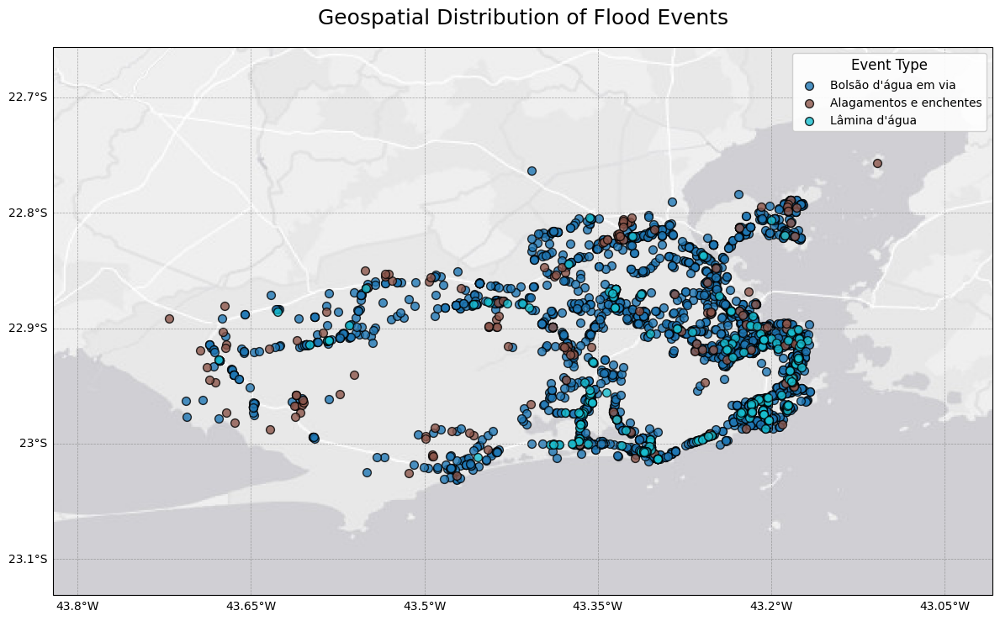

In [12]:
import matplotlib.pyplot as plt
import cartopy.io.img_tiles as cimgt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import matplotlib.cm as cm

class CustomTiles(cimgt.OSM):
    def __init__(self, url, attribution=None):
        super().__init__()
        self._url_template = url
        self.attribution = attribution or "Tile data attribution not set"

    def _image_url(self, tile):
        x, y, z = tile  # Unpack the tile tuple
        return self._url_template.format(z=z, x=x, y=y, s='a')
        
# Dynamically calculate extent based on data with a small padding.
lon_min = ocorrencias['longitude'].min() - 0.1
lon_max = ocorrencias['longitude'].max() + 0.1
lat_min = ocorrencias['latitude'].min() - 0.1
lat_max = ocorrencias['latitude'].max() + 0.1

# Set up a high-resolution figure for publication quality.
fig, ax = plt.subplots(figsize=(12, 10), subplot_kw={'projection': ccrs.PlateCarree()})

# Set the extent to focus on the area where the events are located.
ax.set_extent([lon_min, lon_max, lat_min, lat_max], crs=ccrs.PlateCarree())

# Instead of adding individual physical features, add a high-resolution basemap.
# You can choose from several tile providers; here we use Stamen's terrain background.
# tiler = cimgt.OSM()  

# Choose a clean tile provider
# tile_url = "https://tile.openstreetmap.org/{z}/{x}/{y}.png"
# tile_url = "https://{s}.tile.openstreetmap.fr/hot/{z}/{x}/{y}.png"
# tile_url = "https://{s}.tile.opentopomap.org/{z}/{x}/{y}.png"
tile_url = "https://server.arcgisonline.com/arcgis/rest/services/Canvas/World_Light_Gray_Base/MapServer/tile/{z}/{y}/{x}"
attribution = "© OpenStreetMap contributors"

# Create tile object
tiler = CustomTiles(tile_url, attribution=attribution)
crs = tiler.crs

ax.add_image(tiler, 10)  # Adjust the zoom level as needed.

'''
# --- Neighborhood Boundaries ---
# Replace with your neighborhoods shapefile.
neighborhoods_path = f"{input_data_directory}/dados_mestres/bairro.shp"
neighborhoods_gdf = gpd.read_file(neighborhoods_path)

neighborhoods_gdf = neighborhoods_gdf.to_crs(epsg=4326)
# neighborhoods_gdf = neighborhoods_gdf.to_crs("EPSG:3857")

neighborhoods_gdf.boundary.plot(
    ax=ax,
    edgecolor='black',
    linewidth=0.5,
    label="Neighborhood Boundaries",
#     facecolor='none',     # Fill color
#     edgecolor='#303030',
#     linewidth=1.2,
#     linestyle='-',
    alpha=0.95,
)

ax.legend(loc='lower right', fontsize=10, frameon=True, edgecolor='gray')
'''

# Add gridlines with labels for better geographic reference.
gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True, linewidth=0.5, color='gray', alpha=0.7, linestyle='--')
gl.top_labels = False
gl.right_labels = False
gl.xlabel_style = {'size': 10}
gl.ylabel_style = {'size': 10}

# Group the data by 'tipo' and assign each group a unique color.
unique_types = ocorrencias['tipo'].unique()
cmap = cm.get_cmap('tab10', len(unique_types))
colors = {etype: cmap(i) for i, etype in enumerate(unique_types)}

# Plot each event type with enhanced markers.
for etype in unique_types:
    subset = ocorrencias[ocorrencias['tipo'] == etype]
    ax.scatter(subset['longitude'], subset['latitude'],
               label=etype,
               color=colors[etype],
               s=50,           # Increased marker size for better visibility.
               edgecolor='k',  # Black edges for enhanced contrast.
               alpha=0.8,
               transform=ccrs.PlateCarree())

# Enhance and configure the legend.
legend = ax.legend(title='Event Type', loc='upper right', frameon=True, fontsize=10, title_fontsize=12)
legend.get_frame().set_alpha(0.9)
plt.title('Geospatial Distribution of Flood Events', fontsize=18, pad=20)
plt.tight_layout()

plt.savefig(
    "maps/flood_distribution_esri_wlgb.png",     # or .pdf, .svg, .tiff for vector/raster as needed
    dpi=300,                    # High resolution (300+ DPI for print quality)
    bbox_inches='tight',       # Trim extra whitespace
    pad_inches=0.1,            # Optional padding around the figure
    transparent=True           # Keeps background transparent if needed
)
plt.show()



### Geospatial Distribution By Event Type

#### With Plotly' Scatter Map (Interactive + Web Tiles)

In [55]:
import plotly.graph_objects as go

# Map settings
padding_x = 0.0
padding_y = 0.0
lat_min = ocorrencias['latitude'].min() - padding_x - 0.04
lat_max = ocorrencias['latitude'].max() + padding_x
lon_min = ocorrencias['longitude'].min() - padding_y
lon_max = ocorrencias['longitude'].max() + padding_y
center = {"lat": (lat_min + lat_max)/2, "lon": (lon_min + lon_max)/2}

# Create a single figure
fig = go.Figure()

# Add traces for each event type
event_types = ocorrencias['tipo'].unique()
for event_type in event_types:
    subset = ocorrencias[ocorrencias['tipo'] == event_type]
    fig.add_trace(
        go.Scattermapbox(
            lat=subset['latitude'],
            lon=subset['longitude'],
            mode='markers',
            name=event_type,
            marker=dict(size=8),
            showlegend=True
        )
    )

# Layout and styling
fig.update_layout(
    title_text="Geospatial Distribution by Event Type",
    height=800,
    width=1200,
    margin=dict(l=0, r=0, t=80, b=0),
    mapbox=dict(
        style="carto-positron",
        center=center,
        zoom=10.2
    ),
    legend=dict(title="Event Type", orientation="h", yanchor="bottom", y=0.01, xanchor="center", x=0.5)
)

fig.show()


/tmp/ipykernel_314809/4131978237.py:20: DeprecationWarning:

*scattermapbox* is deprecated! Use *scattermap* instead. Learn more at: https://plotly.com/python/mapbox-to-maplibre/



### Geospatial Distribution By Event Type (Separate Views)

#### With Plotly' Scatter Map (Interactive + Web Tiles)

In [80]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# List of unique event types
event_types = ocorrencias['tipo'].unique()
n_cols = 3
n_rows = int(np.ceil(len(event_types) / n_cols))

# Create subplot figure
fig = make_subplots(rows=n_rows, cols=n_cols,
                    subplot_titles=event_types,
                    specs=[[{"type": "mapbox"} for _ in range(n_cols)] for _ in range(n_rows)],
                    horizontal_spacing=0.05, vertical_spacing=0.05)

# Map settings
padding_x = 0.0
padding_y = 0.0
lat_min = ocorrencias['latitude'].min() - padding_x - 0.04
lat_max = ocorrencias['latitude'].max() + padding_x
lon_min = ocorrencias['longitude'].min() - padding_y
lon_max = ocorrencias['longitude'].max() + padding_y
center = {"lat": (lat_min + lat_max)/2, "lon": (lon_min + lon_max)/2}

# Add traces for each type
for idx, event_type in enumerate(event_types):
    row = idx // n_cols + 1
    col = idx % n_cols + 1
    subset = ocorrencias[ocorrencias['tipo'] == event_type]

    fig.add_trace(
        go.Scattermapbox(
            lat=subset['latitude'],
            lon=subset['longitude'],
            mode='markers',
            marker=dict(size=6),
            name=event_type,
            showlegend=True
        ),
        row=row, col=col
    )

# Update layout
fig.update_layout(
    title_text="Geospatial Distribution by Event Type",
    height=400 * n_rows,
    width=1350,
    margin=dict(l=0, r=0, t=100, b=0),
    mapbox_style="carto-positron",
    mapbox_center=center,
    mapbox_zoom=10.2,
    legend=dict(title="Event Type", orientation="h", yanchor="bottom", y=-0.25, xanchor="center", x=0.5)
)

# Apply the same mapbox settings to all subplots
for i in range(1, n_rows * n_cols + 1):
    fig.layout[f'mapbox{i}'].center = center
    fig.layout[f'mapbox{i}'].zoom = 8.6
    fig.layout[f'mapbox{i}'].style = "carto-positron"

fig.show()


/tmp/ipykernel_314809/2559764747.py:31: DeprecationWarning:

*scattermapbox* is deprecated! Use *scattermap* instead. Learn more at: https://plotly.com/python/mapbox-to-maplibre/



### Beighborhood Maps

#### With contextily

In [106]:
dir(ctx.providers.Esri)

['AntarcticBasemap',
 'AntarcticImagery',
 'ArcticImagery',
 'ArcticOceanBase',
 'ArcticOceanReference',
 'NatGeoWorldMap',
 'OceanBasemap',
 'WorldGrayCanvas',
 'WorldImagery',
 'WorldPhysical',
 'WorldShadedRelief',
 'WorldStreetMap',
 'WorldTerrain',
 'WorldTopoMap']

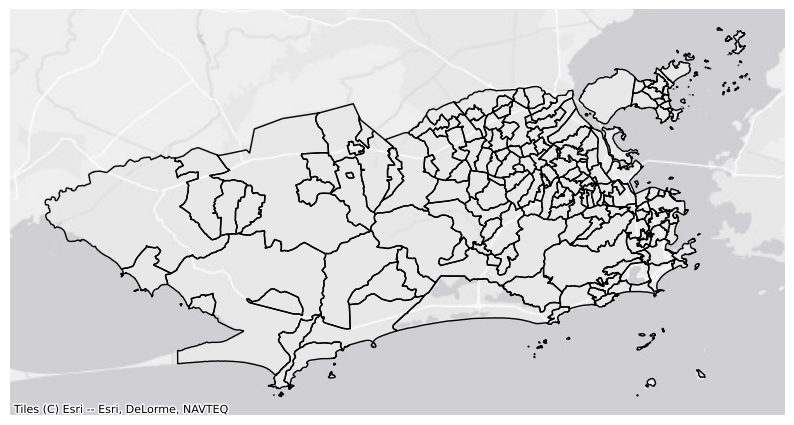

In [141]:
import contextily as ctx
import matplotlib.pyplot as plt

# Read your data and ensure it has a proper CRS
neighborhoods_path = f"{input_data_directory}/dados_mestres/bairro.shp"
neighborhoods_gdf = gpd.read_file(neighborhoods_path)
# Convert to Web Mercator (EPSG:3857) for tile providers
neighborhoods_web_merc = neighborhoods_gdf.to_crs(epsg=3857)

ax = neighborhoods_web_merc.plot(figsize=(10, 8), edgecolor='black', facecolor='none')
# Add a basemap from contextily
ctx.add_basemap(ax, source=ctx.providers.Esri.WorldGrayCanvas)
# Optionally adjust plot extent to data bounds
ax.set_axis_off()  # Hide axis for a clean look
plt.show()


#### With Plotly Express / Plotly (Interactive + Web Tiles)

In [179]:
import geopandas as gpd
import plotly.express as px

# Load data
neighborhoods_path = f"{input_data_directory}/dados_mestres/bairro.shp"
gdf = gpd.read_file(neighborhoods_path).to_crs(epsg=4326)
geojson_dict = gdf.__geo_interface__

fig = px.choropleth_map(
    gdf,
    geojson=geojson_dict,
    locations=gdf.index,
    color=[0 for i in range(len(gdf))],  # choose a field with numeric values for the gradient
    map_style="carto-positron",
    center={"lat": -22.9, "lon": -43.45},
    zoom=9.5,
    # opacity=1,
    color_continuous_scale="Viridis"  # a valid colorscale name
)
fig.show()
